In [39]:
#import packages 
import numpy as np
import pandas as pd
import os
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn import tree
from sklearn.metrics import accuracy_score,confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, roc_curve, auc
from sklearn.metrics import recall_score,precision_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier

#### Importing Dataset

In [37]:
#training_df = pd.read_csv("C:/Users/winot/OneDrive/Desktop/Machine Learning Source Data/train.csv")
#testing_df = pd.read_csv("C:/Users/winot/OneDrive/Desktop/Machine Learning Source Data/test.csv")

# full_data = pd.read_excel("C:/Users/winot/OneDrive/Desktop/full_data.xlsx")

# merged_data = pd.read_csv("C:/Users/winot/OneDrive/Desktop/Merged Data.csv")

# full_data_dummy = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Machine Learning Analytics/Project/Full Data Dummy.csv")

full_data_dummy_cleaned = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Machine Learning Analytics/Project/Full Data Dummy Without ID and Correlated Values.csv")

no_eco = pd.read_csv("C:/Users/winot/OneDrive/Desktop/no_eco_data.csv")

In [274]:
full_data_dummy.shape

(129880, 26)

## Data Exploration

#### Checking Shape of Dataset

In [9]:
# checking the shape of the data 

print(f"training data shape = {training_df.shape}")

print("=========================================")

print(f"training data shape = {testing_df.shape}")

training data shape = (103904, 25)
training data shape = (25976, 25)


#### Merging Training and Testing to Full Data

In [27]:
full_data = pd.concat([training_df, testing_df])

In [29]:
full_data.shape

(129880, 25)

In [155]:
full_data.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


#### Removing Unamed:0 Column

In [31]:
full_data.drop("id", axis = 1, inplace = True)

In [33]:
full_data.head()

,Unnamed: 0,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


#### Checking Variable Types

In [35]:
# checking data types for each variable in the dataset 

def check_data_types(df):
    data_types = df.dtypes
    print("Data types of each .variable:")
    print(data_types)
    return data_types


data_types = check_data_types(full_data_dummy_cleaned)

Data types of each .variable:
Unnamed: 0                           int64
Age                                  int64
Flight Distance                      int64
Inflight wifi service                int64
Departure/Arrival time convenient    int64
Ease of Online booking               int64
Gate location                        int64
Food and drink                       int64
Online boarding                      int64
Seat comfort                         int64
Inflight entertainment               int64
On-board service                     int64
Leg room service                     int64
Baggage handling                     int64
Checkin service                      int64
Inflight service                     int64
Cleanliness                          int64
Departure Delay in Minutes           int64
Gender_Male                          int64
Customer Type_Loyal Customer         int64
Type of Travel_Business travel       int64
Class_Business                       int64
satisfaction_satisfied  

#### Checking Frequency Distribution of Data

In [33]:
# making frequency distribution for all the variables 

def frequency_distribution(df):
    for column in df.columns:
        print(f"Frequency distribution for column: {column}")
        
        # Count of unique values
        counts = df[column].value_counts(dropna=False)
        
        # Percentage of unique values
        percentages = (counts / len(df)) * 100
        
        # Create a DataFrame to display counts and percentages together
        distribution_df = pd.DataFrame({'Count': counts, 'Percentage': round(percentages,2)})
        
        print(distribution_df)
        print("/n" + "="*40 + "/n")
    
frequency_distribution(full_data_dummy_cleaned)

Frequency distribution for column: Age
     Count  Percentage
Age                   
39    3681        2.84
25    3501        2.70
40    3203        2.47
44    3099        2.39
41    3081        2.38
..     ...         ...
74      61        0.05
76      60        0.05
79      52        0.04
78      44        0.03
85      25        0.02

[75 rows x 2 columns]
/n========================================/n
Frequency distribution for column: Flight Distance
                 Count  Percentage
Flight Distance                   
337                840        0.65
594                505        0.39
404                479        0.37
862                472        0.36
2475               465        0.36
...                ...         ...
392                  1        0.00
1019                 1        0.00
1181                 1        0.00
730                  1        0.00
884                  1        0.00

[3821 rows x 2 columns]
/n========================================/n
Frequency distribu

#### Checking Missing Values

In [37]:
def missing_percentage(df):
    # Replace empty strings with NaN (if not handled during import)
    df.replace("", pd.NA, inplace=True)
    
    # Calculate percentage of missing values for each column
    missing_percentage = df.isnull().mean() * 100
    
    # Sort values in descending order for better readability
    missing_percentage = missing_percentage.sort_values(ascending=False)
    
    # Print the result for all columns
    print("Percentage of missing values in each column:/n")
    print(missing_percentage)
    
    # Show only columns with missing values
    missing_columns = missing_percentage[missing_percentage > 0]
    if not missing_columns.empty:
        print("")
        print("================================")
        print("/nColumns with missing values:/n")
        print(missing_columns)

# Example usage
# df = pd.read_csv('your_data.csv', na_values=missing_values)
missing_percentage(full_data)

Percentage of missing values in each column:/n
Arrival Delay in Minutes             0.302587
id                                   0.000000
Gender                               0.000000
Departure Delay in Minutes           0.000000
Cleanliness                          0.000000
Inflight service                     0.000000
Checkin service                      0.000000
Baggage handling                     0.000000
Leg room service                     0.000000
On-board service                     0.000000
Inflight entertainment               0.000000
Seat comfort                         0.000000
Online boarding                      0.000000
Food and drink                       0.000000
Gate location                        0.000000
Ease of Online booking               0.000000
Departure/Arrival time convenient    0.000000
Inflight wifi service                0.000000
Flight Distance                      0.000000
Class                                0.000000
Type of Travel                   

In [39]:
full_data.isnull().sum()

id                                     0
Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             393
satisfaction                           0
dtype: int64

#### Checking Descriptive Stats for Numerical Variable

In [37]:
def descriptive_statistics(df):
    # Select only numerical columns
    numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns
    
    # Create a DataFrame to store the results
    stats = pd.DataFrame(columns=['Mean', 'Median', 'Mode', 'Standard Deviation', 'Min', 'Max', 'variance','Q1', 'Q3', 'IQR', 'Lower Bound', 'Upper Bound'])
    
    for column in numerical_columns:
        mean = df[column].mean()
        median = df[column].median()
        mode = df[column].mode().tolist()  # Convert mode to a list
        
        # If there are multiple modes, show the first one; otherwise, show the mode value
        mode_value = mode[0] if mode else None
        variance = df[column].var()
        std_dev = df[column].std()
        min_value = df[column].min()
        max_value = df[column].max()

        # Calculate Q1, Q3, and IQR
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        
        # Calculate lower and upper bounds for outlier detection
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        # Append the statistics for the current column to the DataFrame
        stats.loc[column] = [mean, median, mode_value, variance, std_dev, min_value, max_value, Q1, Q3, IQR, lower_bound, upper_bound]
    
    # Print the descriptive statistics
    print("Descriptive Statistics for Numerical Variables:")
    print(stats)

descriptive_statistics(full_data_dummy_cleaned)

Descriptive Statistics for Numerical Variables:
                                          Mean  Median   Mode  \
Age                                  39.428761    40.0   39.0   
Flight Distance                    1190.210662   844.0  337.0   
Inflight wifi service                 2.728544     3.0    2.0   
Departure/Arrival time convenient     3.057349     3.0    4.0   
Ease of Online booking                2.756786     3.0    3.0   
Gate location                         2.976909     3.0    3.0   
Food and drink                        3.204685     3.0    4.0   
Online boarding                       3.252720     3.0    4.0   
Seat comfort                          3.441589     4.0    4.0   
Inflight entertainment                3.358067     4.0    4.0   
On-board service                      3.383204     4.0    4.0   
Leg room service                      3.351078     4.0    4.0   
Baggage handling                      3.631886     4.0    4.0   
Checkin service                       3.30

#### Check Proportion of Duplicate Records in the Dataset

In [35]:
def check_duplicates(df):
    # Count duplicate rows
    duplicate_count = df.duplicated().sum()
    
    # Calculate total rows and proportion of duplicates
    total_rows = len(df)
    duplicate_proportion = duplicate_count / total_rows if total_rows > 0 else 0

    # Print results
    print(f"Number of duplicate rows: {duplicate_count}")
    print(f"Proportion of duplicate rows: {duplicate_proportion:.4f} ({duplicate_proportion * 100:.2f}%)")
    
    return duplicate_count, duplicate_proportion

duplicate_rows, duplicate_ratio = check_duplicates(full_data_dummy_cleaned)

Number of duplicate rows: 0
Proportion of duplicate rows: 0.0000 (0.00%)


#### Check Proportion of Outliers Records in the Dataset

In [41]:
def percentage_of_outliers(df):
    # Select only numerical columns
    numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns
    
    # Dictionary to store the percentage of outliers for each column
    outlier_percentages = {}
    
    for column in numerical_columns:
        # Calculate Q1 (25th percentile) and Q3 (75th percentile)
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        
        # Define outlier bounds
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        # Identify outliers
        outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
        
        # Calculate percentage of outliers
        if not outliers.empty:
            outlier_percentage = (len(outliers) / len(df)) * 100
            outlier_percentages[column] = {
                "percentage": outlier_percentage,
                "examples": outliers[column].head(5)  # Get first 5 outlier examples
            }
    
    # Print results
    if outlier_percentages:
        print("Numerical variables with outliers and their percentages:")
        for column, data in outlier_percentages.items():
            print(f"Column '{column}': {data['percentage']:.2f}% outliers")
            print("Examples of outliers:")
            print(data["examples"].to_string(index=False), "/n")  # Print outlier examples
    else:
        print("No outliers detected in any numerical variable.")

percentage_of_outliers(full_data_dummy_cleaned)

Numerical variables with outliers and their percentages:
Column 'Flight Distance': 2.20% outliers
Examples of outliers:
3960
3747
3854
3753
3995 

Column 'Checkin service': 12.40% outliers
Examples of outliers:
1
1
1
1
1 

Column 'Departure Delay in Minutes': 13.88% outliers
Examples of outliers:
 43
 49
 52
 54
109 

Column 'Arrival Delay in Minutes': 13.51% outliers
Examples of outliers:
 35.0
 51.0
 44.0
120.0
 48.0 

Column 'Customer Type_Loyal Customer': 18.31% outliers
Examples of outliers:
0
0
0
0
0 



## Data Visualization (Kimberly and Sophia)

#### Heatmap Prior to Dummying

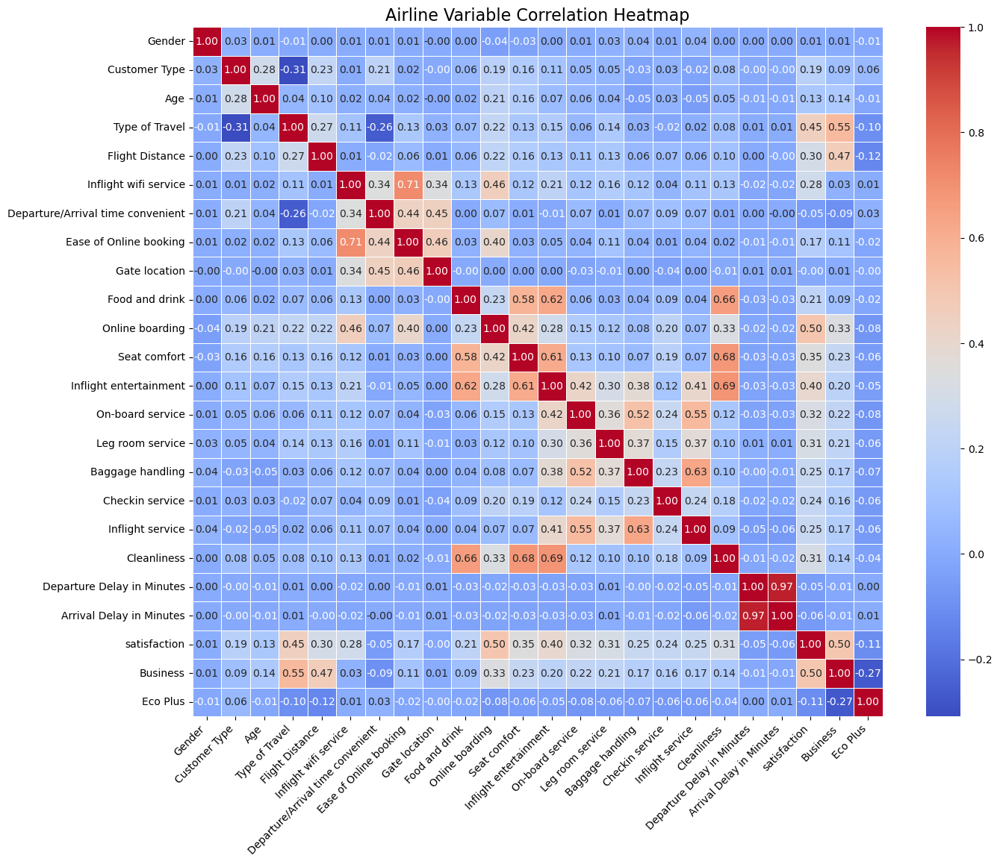

Heatmap saved as C:/Users/winot/OneDrive/Desktop/correlation_heatmap_no_eco.png


In [45]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Example: Create a sample dataset
# Replace this with your actual dataset


# no_eco.drop("Unnamed: 0", inplace = True, axis = 1)

# Calculate the correlation matrix
correlation_matrix = no_eco.corr()

# Set up the Matplotlib figure
plt.figure(figsize=(15, 12))  # Adjust dimensions

# Create a heatmap using Seaborn
sns.heatmap(
    correlation_matrix,
    annot=True,  # Show the correlation coefficients on the heatmap
    fmt='.2f',   # Format the coefficients
    cmap='coolwarm',  # Color scheme
    square=True,  # Optional: Force square cells
    cbar=True,    # Show the color bar
    linewidths=0.5,  # Line width between cells
)

plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels
plt.yticks(rotation=0)  # Keep y-axis labels horizontal

# Set title
plt.title('Airline Variable Correlation Heatmap', fontsize=16)

# Save the heatmap as an image
output_path = "C:/Users/winot/OneDrive/Desktop/correlation_heatmap_no_eco.png"
plt.savefig(output_path, dpi=300, bbox_inches='tight')  # Save as PNG with high resolution

# Display the heatmap
plt.show()

print(f"Heatmap saved as {output_path}")


#### Heatmap Post to Dummying

In [308]:
full_data_dummy.shape

(129880, 25)

## Data Cleaning 

#### Making dummy variables 

In [43]:
full_data.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


In [7]:
full_data_dummy = pd.get_dummies(full_data)

NameError: name 'full_data' is not defined

In [9]:
full_data_dummy_cleaned.head()

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,...,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Gender_Male,Customer Type_Loyal Customer,Type of Travel_Business travel,Class_Business,satisfaction_satisfied
0,13,460,3,4,3,1,5,3,5,5,...,4,4,5,5,25,1,1,0,0,0
1,25,235,3,2,3,3,1,3,1,1,...,3,1,4,1,1,1,0,1,1,0
2,26,1142,2,2,2,2,5,5,5,5,...,4,4,4,5,0,0,1,1,1,1
3,25,562,2,5,5,5,2,2,2,2,...,3,1,4,2,11,0,1,1,1,0
4,61,214,3,3,3,3,4,5,5,3,...,4,3,3,3,0,1,1,1,1,1


In [7]:
full_data_dummy_cleaned.drop("Unnamed: 0", axis = 1, inplace = True)

In [11]:
data_types = check_data_types(full_data_dummy)

NameError: name 'check_data_types' is not defined

In [51]:
# Dropping alternate dummy variables 

full_data_dummy.drop(["Gender_Female", "Customer Type_disloyal Customer", "Type of Travel_Personal Travel", "Class_Eco Plus", "satisfaction_neutral or dissatisfied"],axis = 1, inplace = True)

In [57]:
# Transforming boolean values into 1 and 0 using apply and lambda

full_data_dummy["Gender_Male"]  = full_data_dummy["Gender_Male"].apply(lambda x: 1 if x == True else 0)
full_data_dummy["Customer Type_Loyal Customer"]  = full_data_dummy["Customer Type_Loyal Customer"].apply(lambda x: 1 if x == True else 0)
full_data_dummy["Type of Travel_Business travel"]  = full_data_dummy["Type of Travel_Business travel"].apply(lambda x: 1 if x == True else 0)
full_data_dummy["Class_Business"]  = full_data_dummy["Class_Business"].apply(lambda x: 1 if x == True else 0)
full_data_dummy["Class_Eco"]  = full_data_dummy["Class_Eco"].apply(lambda x: 1 if x == True else 0)
full_data_dummy["satisfaction_satisfied"]  = full_data_dummy["satisfaction_satisfied"].apply(lambda x: 1 if x == True else 0)

In [11]:
full_data_dummy.head()

,Unnamed: 0,id,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,...,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Gender_Male,Customer Type_Loyal Customer,Type of Travel_Business travel,Class_Business,Class_Eco,satisfaction_satisfied
0,0,70172,13,460,3,4,3,1,5,3,...,5,5,25,18.0,1,1,0,0,0,0
1,1,5047,25,235,3,2,3,3,1,3,...,4,1,1,6.0,1,0,1,1,0,0
2,2,110028,26,1142,2,2,2,2,5,5,...,4,5,0,0.0,0,1,1,1,0,1
3,3,24026,25,562,2,5,5,5,2,2,...,4,2,11,9.0,0,1,1,1,0,0
4,4,119299,61,214,3,3,3,3,4,5,...,3,3,0,0.0,1,1,1,1,0,1


In [9]:
full_data_dummy.shape

(129880, 26)

In [ ]:
# Exporting dummied full data to drive 
# full_data_dummy.to_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Machine Learning Analytics/Project/Full Data Dummy.csv")

#### Removing Rows with N/A 

In [19]:
full_data_dummy_cleaned = full_data_dummy.dropna()

In [269]:
full_data_dummy.isnull().sum()

Unnamed: 0                             0
id                                     0
Age                                    0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             393
Gender_Male                            0
Customer Type_Loyal Customer           0
Type of Travel_Business travel         0
Class_Business                         0
Class_Eco       

In [132]:
full_data_dummy_cleaned.head()

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,...,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Gender_Male,Customer Type_Loyal Customer,Type of Travel_Business travel,Class_Business,satisfaction_satisfied
0,13,460,3,4,3,1,5,3,5,5,...,4,4,5,5,25,1,1,0,0,0
1,25,235,3,2,3,3,1,3,1,1,...,3,1,4,1,1,1,0,1,1,0
2,26,1142,2,2,2,2,5,5,5,5,...,4,4,4,5,0,0,1,1,1,1
3,25,562,2,5,5,5,2,2,2,2,...,3,1,4,2,11,0,1,1,1,0
4,61,214,3,3,3,3,4,5,5,3,...,4,3,3,3,0,1,1,1,1,1


#### Removing Outliers

In [130]:
full_data_dummy_cleaned.drop(["Arrival Delay in Minutes", "Class_Eco"], axis = 1, inplace=True)

In [155]:
full_data_dummy_cleaned.to_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Machine Learning Analytics/Project/Full Data Dummy Without ID and Correlated Values.csv")

# Data Modeling

## Naive Bayes (Jacob)

### Naive Bayes (Gausian)

### Naive Bayes (Multinomial/Bernoulli)

## Decision Tree (Justin)

In [13]:
full_data_dummy_cleaned.head()

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,...,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Gender_Male,Customer Type_Loyal Customer,Type of Travel_Business travel,Class_Business,satisfaction_satisfied
0,13,460,3,4,3,1,5,3,5,5,...,4,4,5,5,25,1,1,0,0,0
1,25,235,3,2,3,3,1,3,1,1,...,3,1,4,1,1,1,0,1,1,0
2,26,1142,2,2,2,2,5,5,5,5,...,4,4,4,5,0,0,1,1,1,1
3,25,562,2,5,5,5,2,2,2,2,...,3,1,4,2,11,0,1,1,1,0
4,61,214,3,3,3,3,4,5,5,3,...,4,3,3,3,0,1,1,1,1,1


#### Splitting data into independent and dependent variables

In [15]:
X = full_data_dummy_cleaned.drop(columns=['satisfaction_satisfied'])
y = full_data_dummy_cleaned['satisfaction_satisfied']
print(X.shape)
print(y.shape)

(129487, 21)
(129487,)


#### Partition the data into training and testing sets 

In [17]:
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

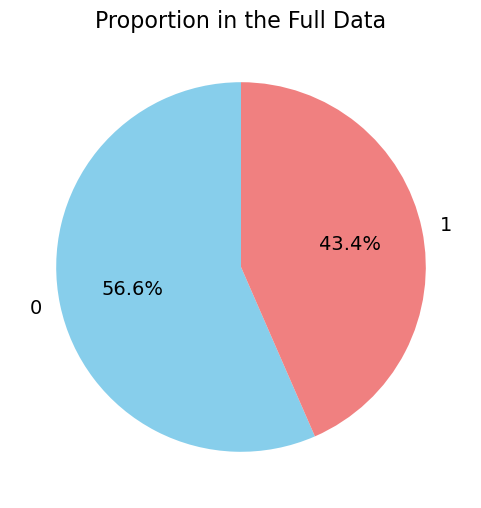

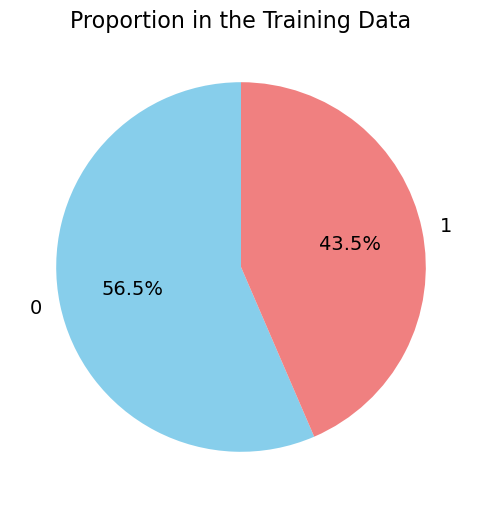

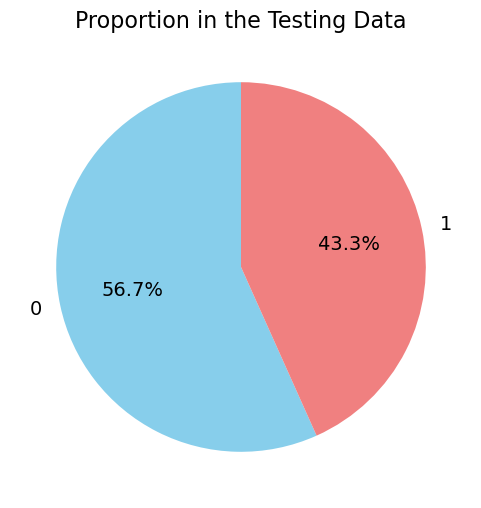

In [19]:
import matplotlib.pyplot as plt

# Calculate proportions
full_proportion = y.value_counts(normalize=True)
train_proportion = y_train.value_counts(normalize=True)
test_proportion = y_test.value_counts(normalize=True)

# Function to create a pie chart with larger text
def plot_pie_chart(proportions, title):
    labels = proportions.index.map(str)  # Convert indices to strings
    sizes = proportions.values
    plt.figure(figsize=(6, 6))
    plt.pie(
        sizes,
        labels=labels,
        autopct='%1.1f%%',
        startangle=90,
        colors=['skyblue', 'lightcoral'],
        textprops={'fontsize': 14}  # Increase text size
    )
    plt.title(title, fontsize=16)  # Increase title size
    plt.show()

# Plot pie charts
plot_pie_chart(full_proportion, "Proportion in the Full Data")
plot_pie_chart(train_proportion, "Proportion in the Training Data")
plot_pie_chart(test_proportion, "Proportion in the Testing Data")



### Decision Tree Pre-processed Baseline Model

#### Creating the model and fitting the dataset

In [142]:
model = tree.DecisionTreeClassifier(criterion='entropy')
model.fit(x_train, y_train)

y_train_pred = model.predict(x_train)
y_test_pred  = model.predict(x_test)

#### Displaying the decision tree and confusion matrix

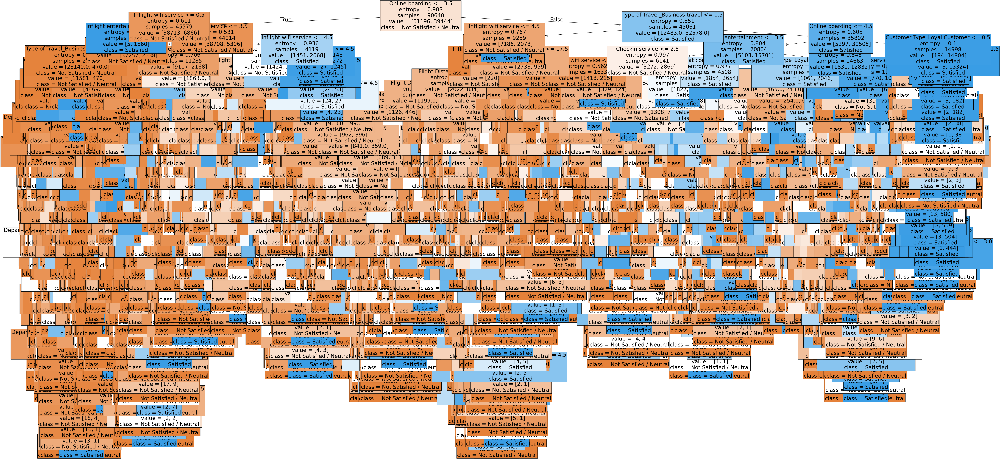

In [144]:
#figsize value changes the size of plot
fig, ax = plt.subplots(figsize=(96, 48), dpi=100)

features = full_data_dummy_cleaned.columns
classes = ['Not Satisfied / Neutral','Satisfied']

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()

In [145]:
def plot_confusionmatrix(y_train_pred,y_train,dom):
    print(f'{dom} Confusion matrix')
    cf = confusion_matrix(y_train, y_train_pred)
    # When annot is set to True, it adds text annotations to each cell of the heatmap.
    sns.heatmap(cf,annot=True,yticklabels=classes,xticklabels=classes,cmap='Blues', fmt='g')
    plt.tight_layout()
    plt.show()

Decision Tree Model Performance:

 > Train score = 100.0%

 > Test score  = 94.81298427162973%

                       precision    recall  f1-score   support

Not Satisfied/Neutral       0.95      0.95      0.95     22029
            Satisfied       0.94      0.94      0.94     16818

             accuracy                           0.95     38847
            macro avg       0.95      0.95      0.95     38847
         weighted avg       0.95      0.95      0.95     38847

Train Confusion matrix


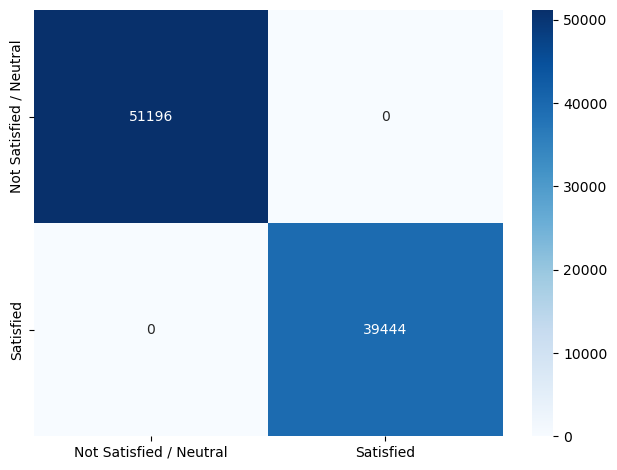

Test Confusion matrix


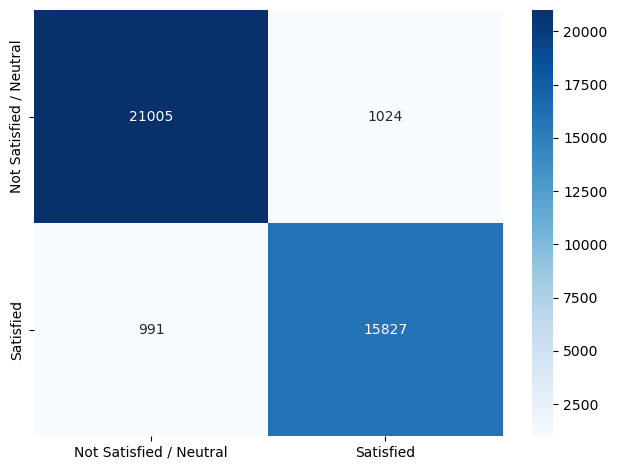

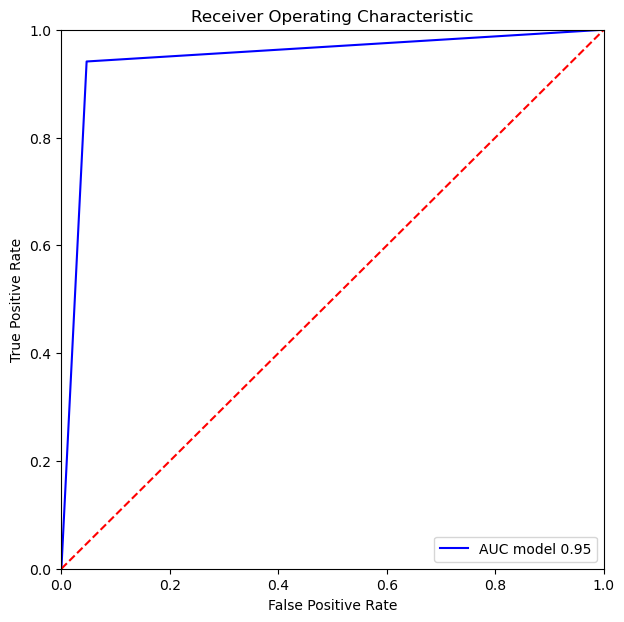

In [146]:
from sklearn.metrics import classification_report

print("Decision Tree Model Performance:/n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%/n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%/n')

print(classification_report(y_test, y_test_pred, target_names = ['Not Satisfied/Neutral', 'Satisfied']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#Plot AUC-ROC

y_proba = model.predict_proba(x_test)[:, 1]


false_positive_rate_1, true_positive_rate_1, thresholds_1 = roc_curve(y_test, y_proba)
roc_auc_1 = auc(false_positive_rate_1, true_positive_rate_1)

 
plt.figure(figsize=(7,7))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate_1, true_positive_rate_1, 'b', label = 'AUC model %0.2f'  % roc_auc_1)

plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

### Decision Tree (Post Processed)

#### Pre-pruning Tree Using Gridsearch v1 (2nd)

In [15]:
params = {
    'max_depth': [19, 20, 21, 22],
    'min_samples_split': [80, 90, 100, 110, 120],
    'min_samples_leaf': [5, 10, 15, 20]
}

clf = tree.DecisionTreeClassifier(criterion='entropy')
gcv = GridSearchCV(estimator=clf,param_grid=params, cv = 10)
gcv.fit(x_train, y_train)

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(criterion='entropy'),
             param_grid={'max_depth': [19, 20, 21, 22],
                         'min_samples_leaf': [5, 10, 15, 20],
                         'min_samples_split': [80, 90, 100, 110, 120]})

In [16]:
model = gcv.best_estimator_
print("Best Fit Model")
print(model)

Best Fit Model
DecisionTreeClassifier(criterion='entropy', max_depth=21, min_samples_leaf=5,
                       min_samples_split=110)


In [17]:
model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

from sklearn.metrics import classification_report

print("Decision Tree Model Performance:/n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%/n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%/n')

print(classification_report(y_test, y_test_pred, target_names = ['Not Satisfied/Neutral', 'Satisfied']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#Plot AUC-ROC

y_proba = model.predict_proba(x_test)[:, 1]


false_positive_rate_1, true_positive_rate_1, thresholds_1 = roc_curve(y_test, y_proba)
roc_auc_1 = auc(false_positive_rate_1, true_positive_rate_1)

 
plt.figure(figsize=(7,7))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate_1, true_positive_rate_1, 'b', label = 'AUC model %0.2f'  % roc_auc_1)

plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

Decision Tree Model Performance:/n
 > Train score = 96.18270079435128%/n
 > Test score  = 95.41792158982676%/n
                       precision    recall  f1-score   support

Not Satisfied/Neutral       0.95      0.97      0.96     22029
            Satisfied       0.96      0.93      0.95     16818

             accuracy                           0.95     38847
            macro avg       0.95      0.95      0.95     38847
         weighted avg       0.95      0.95      0.95     38847



NameError: name 'plot_confusionmatrix' is not defined

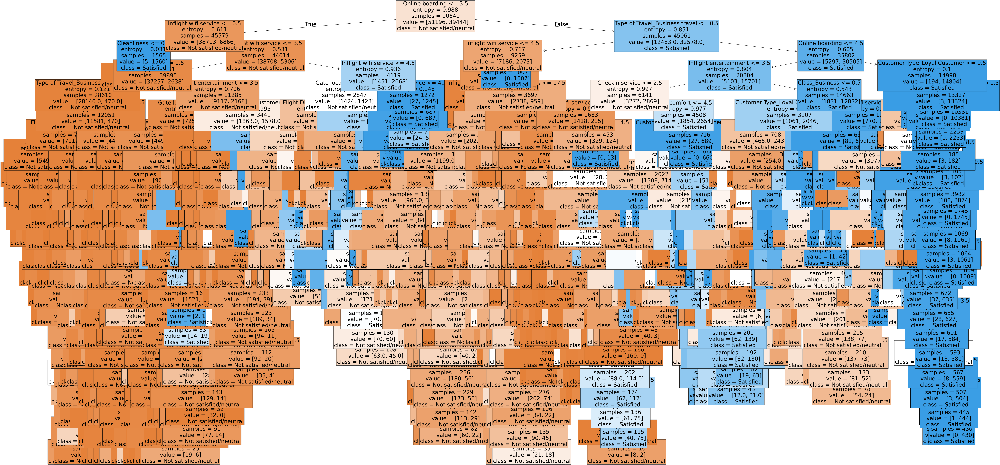

In [193]:
#figsize value changes the size of plot
fig, ax = plt.subplots(figsize=(96, 48), dpi=100)
features = full_data_dummy_cleaned.columns
classes = ['Not satisfied/neutral','Satisfied']

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()

In [194]:
# View cross-validation results for each parameter combination
cv_results = gcv.cv_results_

# Extract the mean cross-validation score for the best parameters
mean_cv_accuracy = gcv.best_score_
print(f"Mean CV Accuracy (10-Fold): {mean_cv_accuracy}")

Mean CV Accuracy (10-Fold): 0.9539827890556045


#### Pre-pruning Tree Using Gridsearch v2 (3rd)

##### Hyperparameter tuning using gridsearch

In [182]:
params = {
        'max_depth': [21, 22, 23, 24],
         'min_samples_split': [100, 110, 120, 130],
         'min_samples_leaf': [3, 5, 7, 10]
}

clf = tree.DecisionTreeClassifier(criterion='entropy')
gcv = GridSearchCV(estimator=clf, param_grid=params, cv=10, scoring='accuracy')
gcv.fit(x_train,y_train)

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(criterion='entropy'),
             param_grid={'max_depth': [21, 22, 23, 24],
                         'min_samples_leaf': [3, 5, 7, 10],
                         'min_samples_split': [100, 110, 120, 130]},
             scoring='accuracy')

##### Making and fitting the model

In [183]:
model = gcv.best_estimator_
print("Best Fit Model")
print(model)

Best Fit Model
DecisionTreeClassifier(criterion='entropy', max_depth=21, min_samples_leaf=3,
                       min_samples_split=110)


Decision Tree Model Performance:/n
 > Train score = 96.1981465136805%/n
 > Test score  = 95.56465106700645%/n
                       precision    recall  f1-score   support

Not Satisfied/Neutral       0.95      0.97      0.96     22029
            Satisfied       0.96      0.93      0.95     16818

             accuracy                           0.96     38847
            macro avg       0.96      0.95      0.95     38847
         weighted avg       0.96      0.96      0.96     38847

Train Confusion matrix


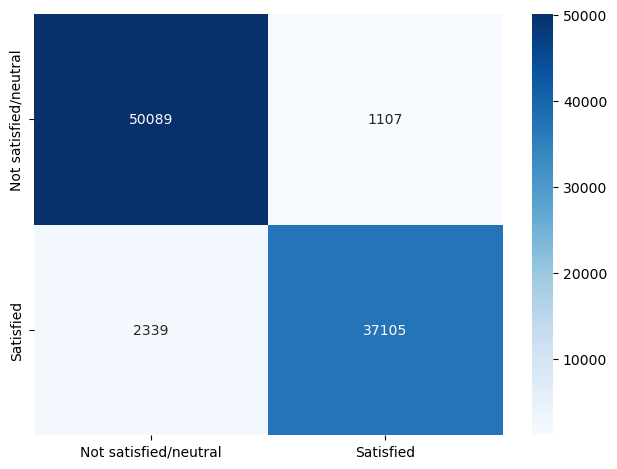

Test Confusion matrix


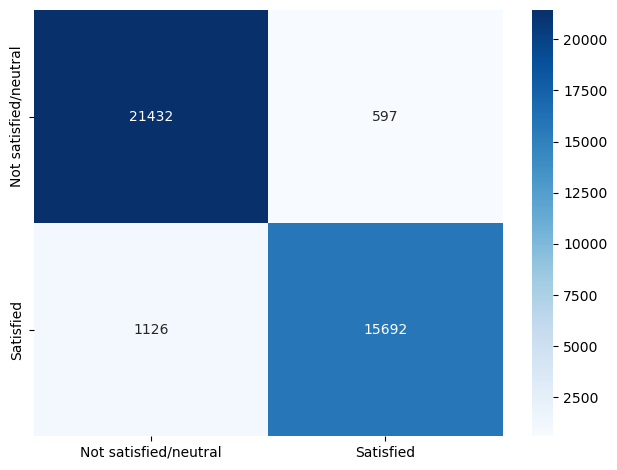

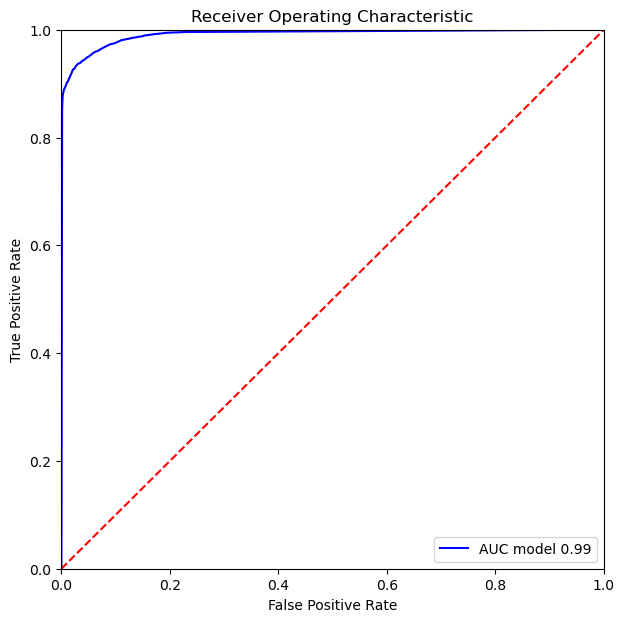

In [184]:
model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

from sklearn.metrics import classification_report

print("Decision Tree Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Not Satisfied/Neutral', 'Satisfied']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#Plot AUC-ROC

y_proba = model.predict_proba(x_test)[:, 1]


false_positive_rate_1, true_positive_rate_1, thresholds_1 = roc_curve(y_test, y_proba)
roc_auc_1 = auc(false_positive_rate_1, true_positive_rate_1)

 
plt.figure(figsize=(7,7))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate_1, true_positive_rate_1, 'b', label = 'AUC model %0.2f'  % roc_auc_1)

plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

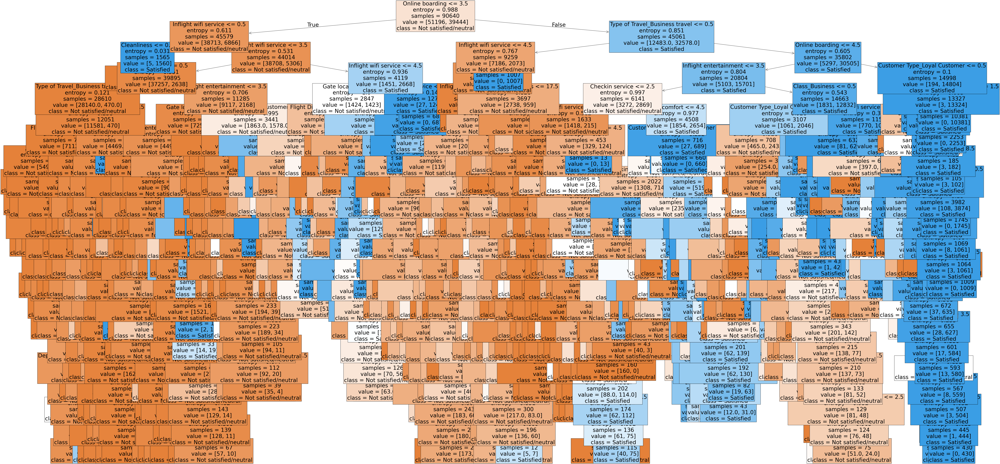

In [185]:
#figsize value changes the size of plot
fig, ax = plt.subplots(figsize=(96, 48), dpi=100)
features = full_data_dummy_cleaned.columns
classes = ['Not satisfied/neutral','Satisfied']

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()


##### 10 fold cross validation

In [186]:
# View cross-validation results for each parameter combination
cv_results = gcv.cv_results_

# Extract the mean cross-validation score for the best parameters
mean_cv_accuracy = gcv.best_score_
print(f"Mean CV Accuracy (10-Fold): {mean_cv_accuracy}")

Mean CV Accuracy (10-Fold): 0.954247572815534


In [187]:
feature_importance = pd.Series(model.feature_importances_, index=x_train.columns).sort_values(ascending=False)
print(feature_importance)

Online boarding                      0.340819
Inflight wifi service                0.216313
Type of Travel_Business travel       0.144850
Inflight entertainment               0.055363
Customer Type_Loyal Customer         0.050564
Class_Business                       0.049558
Checkin service                      0.027267
Gate location                        0.025336
Baggage handling                     0.020532
Inflight service                     0.015216
Seat comfort                         0.013579
Age                                  0.011281
Cleanliness                          0.007657
Leg room service                     0.006591
Flight Distance                      0.005687
On-board service                     0.003725
Departure Delay in Minutes           0.002755
Departure/Arrival time convenient    0.001364
Food and drink                       0.000980
Ease of Online booking               0.000412
Gender_Male                          0.000149
dtype: float64


#### Pre-pruning Tree Using Gridsearch v3 (1st)

In [147]:
params = {
    'max_depth': [15, 17, 19, 20],
    'min_samples_split': [10, 20, 50, 100],
    'min_samples_leaf': [10, 20, 50, 100]
}

clf = tree.DecisionTreeClassifier(criterion='entropy')
gcv = GridSearchCV(estimator=clf, param_grid=params, cv=10, scoring='accuracy')
gcv.fit(x_train,y_train)

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(criterion='entropy'),
             param_grid={'max_depth': [15, 17, 19, 20],
                         'min_samples_leaf': [10, 20, 50, 100],
                         'min_samples_split': [10, 20, 50, 100]},
             scoring='accuracy')

In [148]:
model = gcv.best_estimator_
print("Best Fit Model")
print(model)

Best Fit Model
DecisionTreeClassifier(criterion='entropy', max_depth=20, min_samples_leaf=10,
                       min_samples_split=100)


Decision Tree Model Performance:

 > Train score = 96.11429832303618%

 > Test score  = 95.47970242232347%

                       precision    recall  f1-score   support

Not Satisfied/Neutral       0.95      0.97      0.96     22029
            Satisfied       0.96      0.93      0.95     16818

             accuracy                           0.95     38847
            macro avg       0.96      0.95      0.95     38847
         weighted avg       0.95      0.95      0.95     38847

Train Confusion matrix


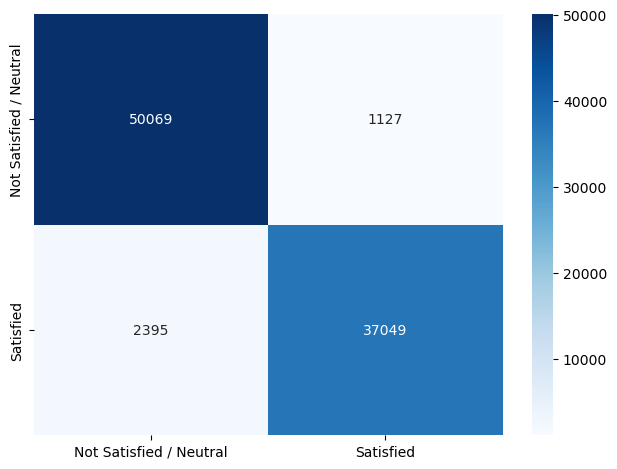

Test Confusion matrix


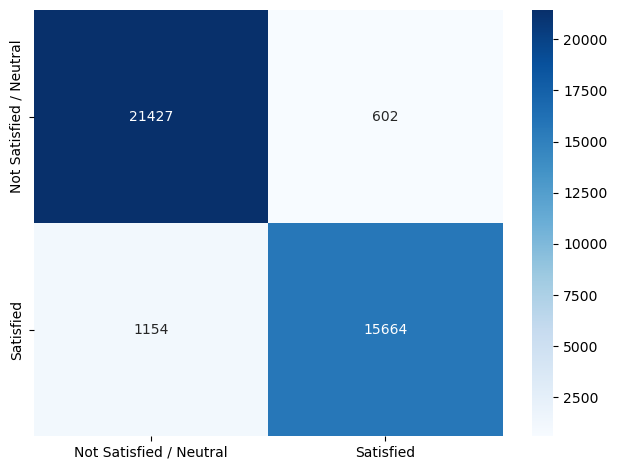

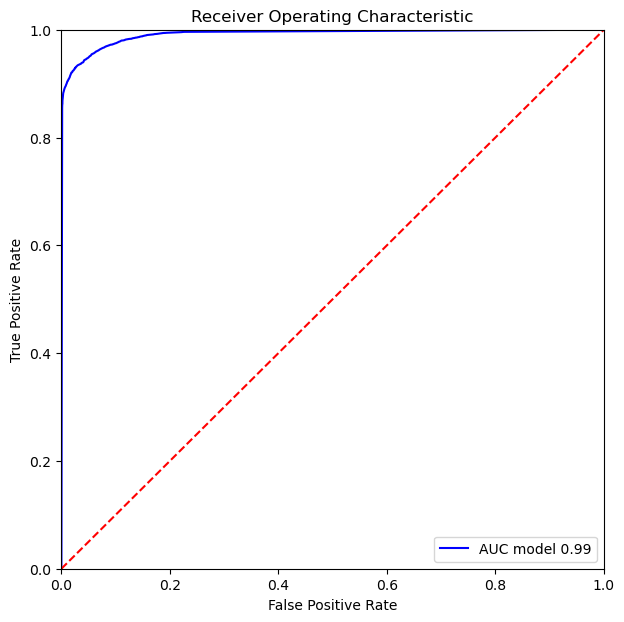

In [149]:
model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

from sklearn.metrics import classification_report

print("Decision Tree Model Performance:/n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%/n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%/n')

print(classification_report(y_test, y_test_pred, target_names = ['Not Satisfied/Neutral', 'Satisfied']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#Plot AUC-ROC

y_proba = model.predict_proba(x_test)[:, 1]


false_positive_rate_1, true_positive_rate_1, thresholds_1 = roc_curve(y_test, y_proba)
roc_auc_1 = auc(false_positive_rate_1, true_positive_rate_1)

 
plt.figure(figsize=(7,7))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate_1, true_positive_rate_1, 'b', label = 'AUC model %0.2f'  % roc_auc_1)

plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

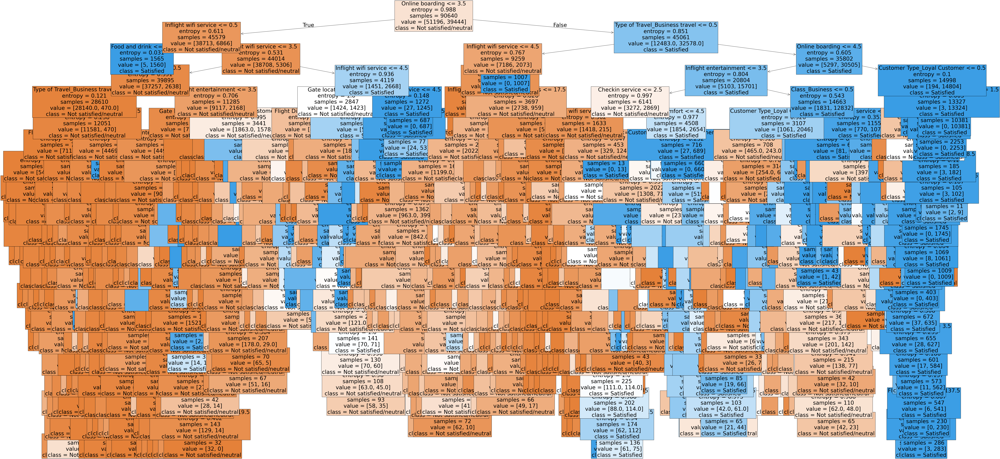

In [150]:
#figsize value changes the size of plot
fig, ax = plt.subplots(figsize=(96, 48), dpi=100)
features = full_data_dummy_cleaned.columns
classes = ['Not satisfied/neutral','Satisfied']

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()

In [151]:
# View cross-validation results for each parameter combination
cv_results = gcv.cv_results_

# Extract the mean cross-validation score for the best parameters
mean_cv_accuracy = gcv.best_score_
print(f"Mean CV Accuracy (10-Fold): {mean_cv_accuracy}")

Mean CV Accuracy (10-Fold): 0.9530450132391879


#### Example Model

Best Fit Model
DecisionTreeClassifier(criterion='entropy', max_depth=6, min_samples_leaf=3,
                       min_samples_split=110)
Decision Tree Model Performance:/n
 > Train score = 91.9991173874669%/n
 > Test score  = 91.8758205266816%/n
                       precision    recall  f1-score   support

Not Satisfied/Neutral       0.94      0.92      0.93     22029
            Satisfied       0.90      0.92      0.91     16818

             accuracy                           0.92     38847
            macro avg       0.92      0.92      0.92     38847
         weighted avg       0.92      0.92      0.92     38847

Train Confusion matrix


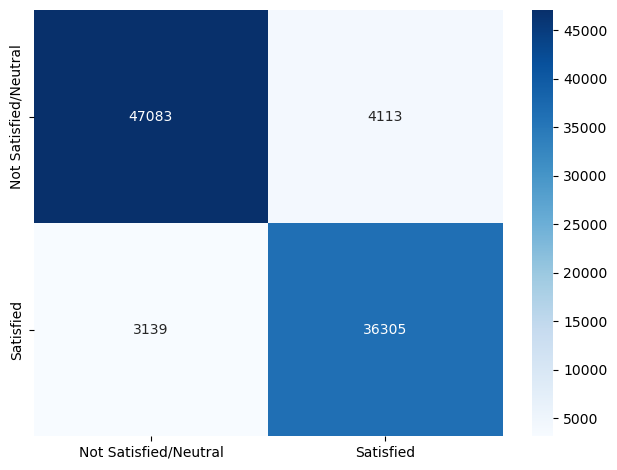

Test Confusion matrix


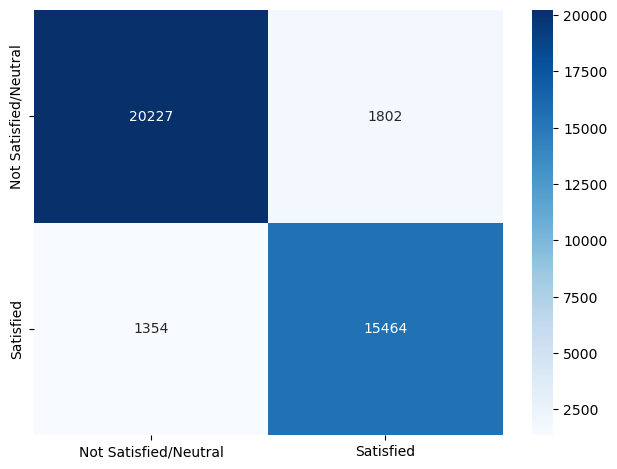

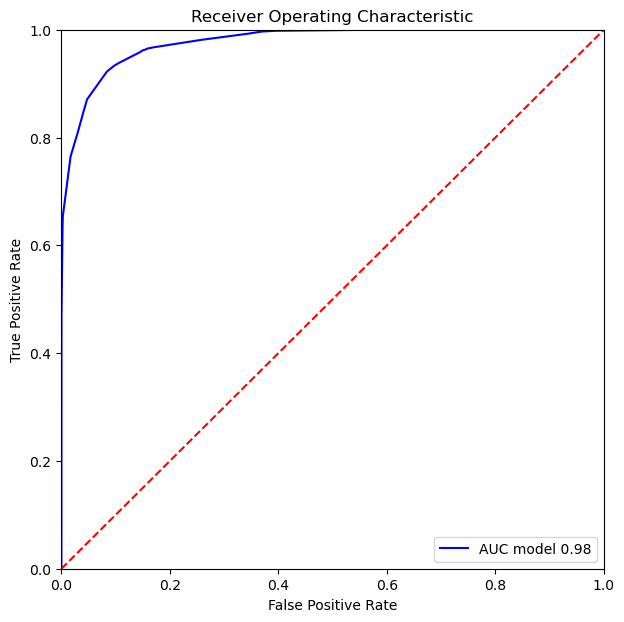

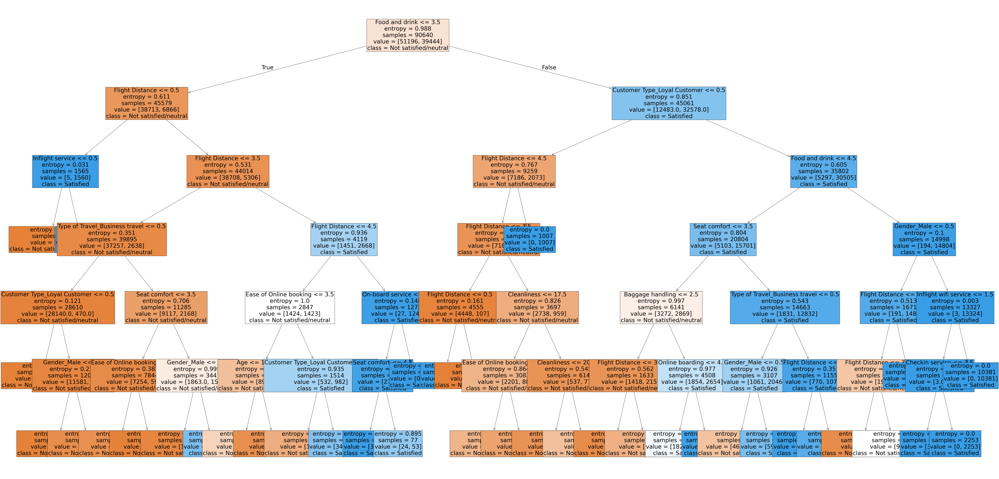

In [313]:
params = {
        'max_depth': [6],
         'min_samples_split': [100, 110, 120, 130],
         'min_samples_leaf': [3, 5, 7, 10]
}

clf = tree.DecisionTreeClassifier(criterion='entropy')
gcv = GridSearchCV(estimator=clf, param_grid=params, cv=10, scoring='accuracy')
gcv.fit(x_train,y_train)

model = gcv.best_estimator_
print("Best Fit Model")
print(model)

model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

from sklearn.metrics import classification_report

print("Decision Tree Model Performance:/n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%/n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%/n')

print(classification_report(y_test, y_test_pred, target_names = ['Not Satisfied/Neutral', 'Satisfied']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#Plot AUC-ROC

y_proba = model.predict_proba(x_test)[:, 1]


false_positive_rate_1, true_positive_rate_1, thresholds_1 = roc_curve(y_test, y_proba)
roc_auc_1 = auc(false_positive_rate_1, true_positive_rate_1)

 
plt.figure(figsize=(7,7))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate_1, true_positive_rate_1, 'b', label = 'AUC model %0.2f'  % roc_auc_1)

plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

#figsize value changes the size of plot
fig, ax = plt.subplots(figsize=(96, 48), dpi=100)
features = full_data_dummy_cleaned.columns
classes = ['Not satisfied/neutral','Satisfied']

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()

#### Decision Tree using SMOTE

In [206]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from imblearn.over_sampling import SMOTE
from collections import Counter

# Splitting the data
X = full_data_dummy_cleaned.drop(columns=['satisfaction_satisfied'])
y = full_data_dummy_cleaned['satisfaction_satisfied']

# Displaying the original proportion of the dependent variable
print("Original class distribution:", Counter(y))

# Splitting into train and test sets
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Applying SMOTE to balance the training data
smote = SMOTE(random_state=42)
x_train_smote, y_train_smote = smote.fit_resample(x_train, y_train)

# Displaying the proportion after SMOTE
print("Class distribution after SMOTE:", Counter(y_train_smote))

# Training the decision tree classifier
model = DecisionTreeClassifier(criterion='entropy', random_state=42)
model.fit(x_train_smote, y_train_smote)

# Making predictions
y_train_pred = model.predict(x_train_smote)
y_test_pred = model.predict(x_test)

# Output proportions before and after
print("Before SMOTE - Training set class distribution:", Counter(y_train))
print("After SMOTE - Training set class distribution:", Counter(y_train_smote))

Original class distribution: Counter({0: 73225, 1: 56262})
Class distribution after SMOTE: Counter({1: 51257, 0: 51257})
Before SMOTE - Training set class distribution: Counter({0: 51257, 1: 39383})
After SMOTE - Training set class distribution: Counter({1: 51257, 0: 51257})


Decision Tree Model Performance:/n
 > Train score = 100.0%
 > Test score  = 94.13339511416584%
                       precision    recall  f1-score   support

Not Satisfied/Neutral       0.96      0.94      0.95     21968
            Satisfied       0.92      0.95      0.93     16879

             accuracy                           0.94     38847
            macro avg       0.94      0.94      0.94     38847
         weighted avg       0.94      0.94      0.94     38847

Train Confusion matrix


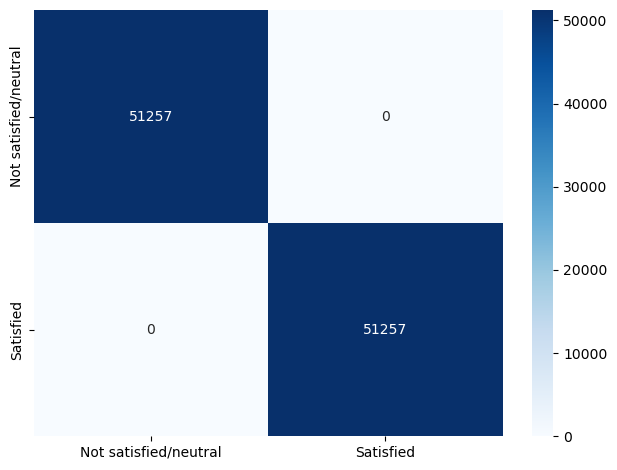

Test Confusion matrix


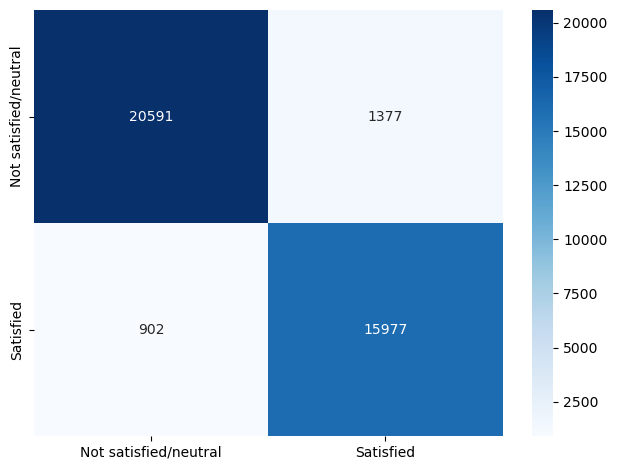

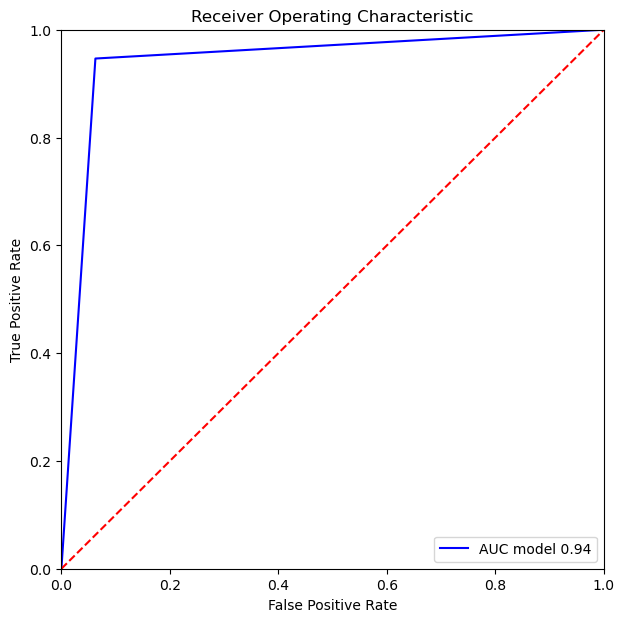

In [214]:
from sklearn.metrics import classification_report

print("Decision Tree Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train_smote)*100}%')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%')

print(classification_report(y_test, y_test_pred, target_names = ['Not Satisfied/Neutral', 'Satisfied']))

plot_confusionmatrix(y_train_pred,y_train_smote,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#Plot AUC-ROC

y_proba = model.predict_proba(x_test)[:, 1]


false_positive_rate_1, true_positive_rate_1, thresholds_1 = roc_curve(y_test, y_proba)
roc_auc_1 = auc(false_positive_rate_1, true_positive_rate_1)

 
plt.figure(figsize=(7,7))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate_1, true_positive_rate_1, 'b', label = 'AUC model %0.2f'  % roc_auc_1)

plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

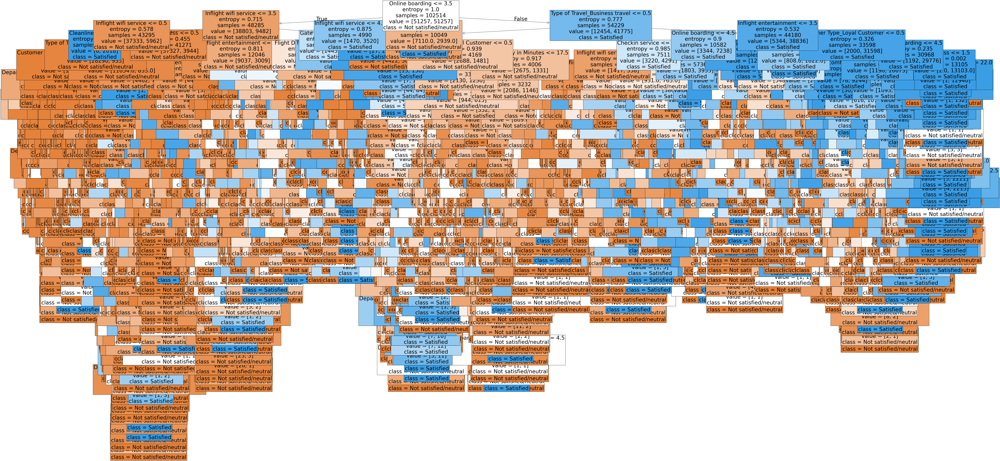

In [216]:
#figsize value changes the size of plot
fig, ax = plt.subplots(figsize=(96, 48), dpi=100)
features = full_data_dummy_cleaned.columns
classes = ['Not satisfied/neutral','Satisfied']

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()

#### Decision Tree SMOTE + Pre pruning (GridSearch)

Decision Tree Model Performance:/n
 > Train score = 95.75684024713152%/n
 > Test score  = 95.096146420573%/n
                       precision    recall  f1-score   support

Not Satisfied/Neutral       0.96      0.95      0.96     21968
            Satisfied       0.94      0.95      0.94     16879

             accuracy                           0.95     38847
            macro avg       0.95      0.95      0.95     38847
         weighted avg       0.95      0.95      0.95     38847

Train Confusion matrix


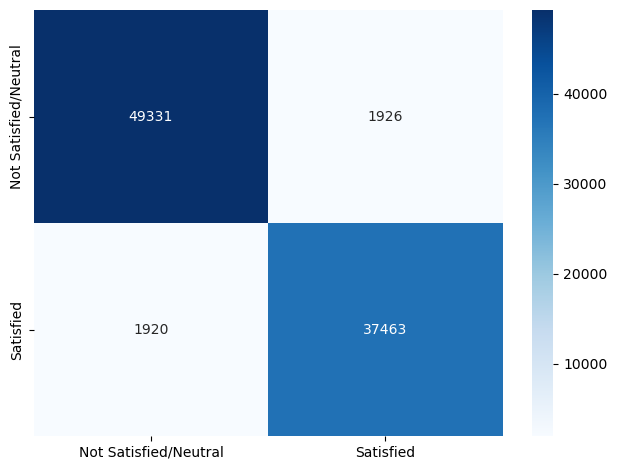

Test Confusion matrix


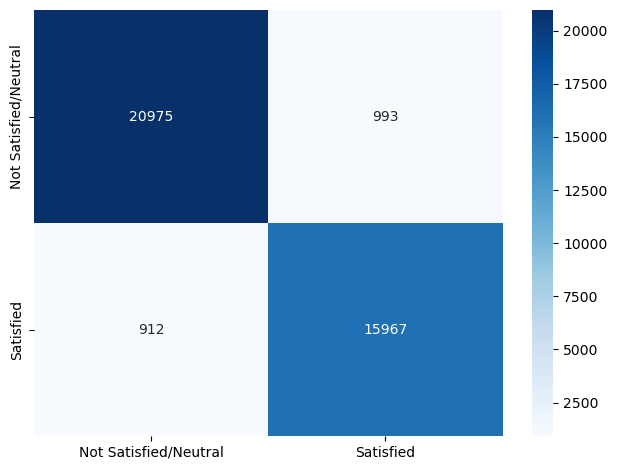

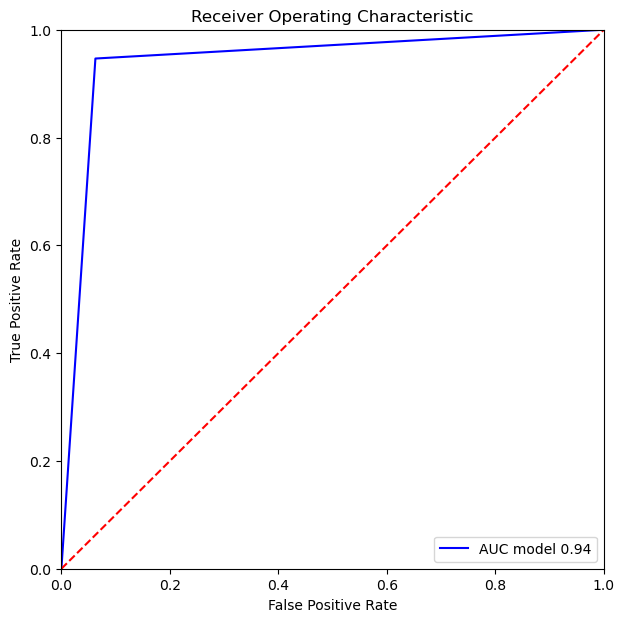

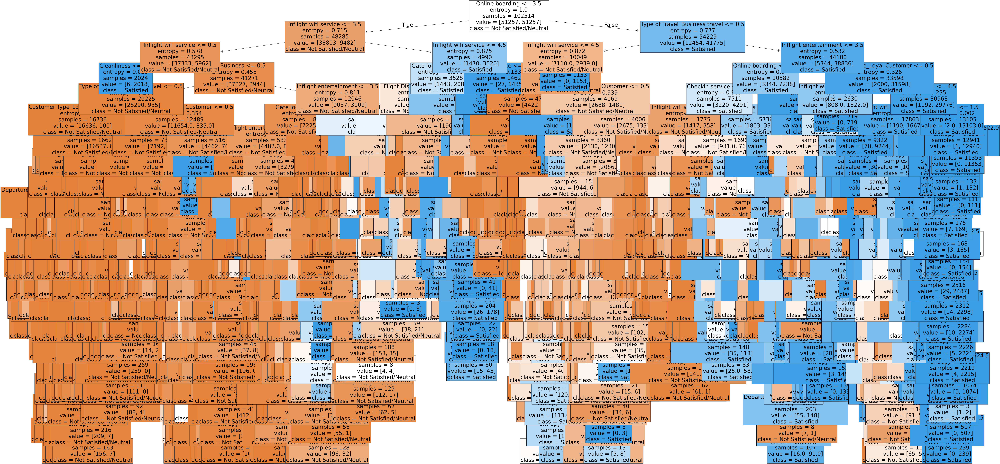

In [220]:
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import accuracy_score, classification_report, roc_curve, auc
import matplotlib.pyplot as plt

# Define the pipeline with SMOTE and the best parameters for the Decision Tree
pipeline = Pipeline([
    ('smote', SMOTE(random_state=42)),  # Apply SMOTE
    ('clf', DecisionTreeClassifier(
        criterion='entropy',
        max_depth=21,
        min_samples_split=110,
        min_samples_leaf=3,
        random_state=42
    ))  # Decision Tree Classifier with best parameters
])

# Fit the pipeline on the training data
pipeline.fit(x_train, y_train)

# Evaluate the model on the training and test sets
y_train_pred = pipeline.predict(x_train)
y_test_pred = pipeline.predict(x_test)


from sklearn.metrics import classification_report

print("Decision Tree Model Performance:/n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%/n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%/n')

print(classification_report(y_test, y_test_pred, target_names = ['Not Satisfied/Neutral', 'Satisfied']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#Plot AUC-ROC

y_proba = model.predict_proba(x_test)[:, 1]


false_positive_rate_1, true_positive_rate_1, thresholds_1 = roc_curve(y_test, y_proba)
roc_auc_1 = auc(false_positive_rate_1, true_positive_rate_1)

 
plt.figure(figsize=(7,7))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate_1, true_positive_rate_1, 'b', label = 'AUC model %0.2f'  % roc_auc_1)

plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

# Plot the decision tree
fig, ax = plt.subplots(figsize=(96, 48), dpi=100)
features = x_train.columns  # Use feature names from your dataset
classes = ['Not Satisfied/Neutral', 'Satisfied']

plot_tree(pipeline.named_steps['clf'], ax=ax, feature_names=features, class_names=classes, filled=True, fontsize=32)
plt.show()



#### Post-pruning Tree v1

In [233]:
path = model.cost_complexity_pruning_path(x_train, y_train)
ccp_alphas, impurities = path.ccp_alphas, path.impurities
print(ccp_alphas)

[0.00000000e+00 4.40537440e-06 5.42438953e-06 ... 2.67354650e-02
 6.40497141e-02 1.63778884e-01]


In [235]:
# For each alpha we will append our model to a list
models = []
for ccp_alpha in ccp_alphas:
    model = tree.DecisionTreeClassifier(criterion = "entropy", random_state=42, ccp_alpha=ccp_alpha)
    model.fit(x_train, y_train)
    models.append(model)

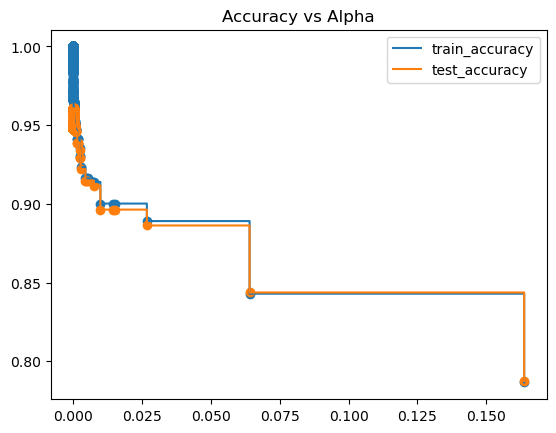

In [236]:
train_acc = []
test_acc  = []

# The code iterates through trained models, predicting 
# and storing their accuracy on both training and testing data.
# It uses scatter plots to show individual accuracies for each alpha value.
# Step plots connect accuracy points to visualize the trend as model complexity changes.
# The resulting graph, titled 'Accuracy vs Alpha', helps identify 
# the optimal balance between model simplicity and accuracy.

for m in models:
    y_train_pred = m.predict(x_train)
    y_test_pred = m.predict(x_test)
    train_acc.append(accuracy_score(y_train_pred,y_train))
    test_acc.append(accuracy_score(y_test_pred,y_test))

plt.scatter(ccp_alphas,train_acc)
plt.scatter(ccp_alphas,test_acc)
plt.plot(ccp_alphas,train_acc,label='train_accuracy',drawstyle="steps-post")
plt.plot(ccp_alphas,test_acc,label='test_accuracy',drawstyle="steps-post")
plt.legend()
plt.title('Accuracy vs Alpha')
plt.show()

Decision Tree Model Performance:/n
 > Train score = 93.62312444836716%

 > Test score  = 93.44865755399387%

                       precision    recall  f1-score   support

Not Satisfied/Neutral       0.93      0.95      0.94     22029
            Satisfied       0.94      0.91      0.92     16818

             accuracy                           0.93     38847
            macro avg       0.93      0.93      0.93     38847
         weighted avg       0.93      0.93      0.93     38847

Train Confusion matrix


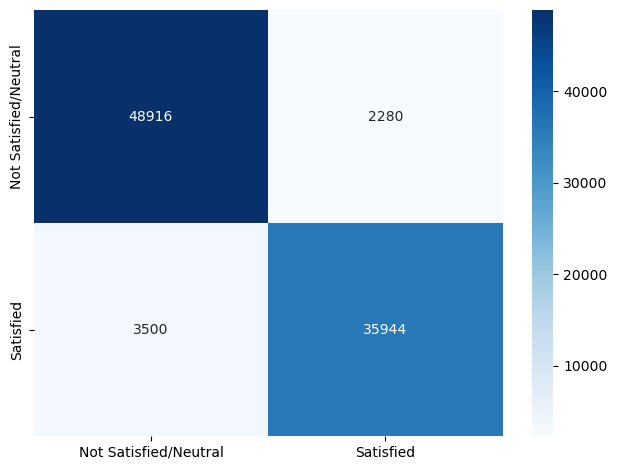

Test Confusion matrix


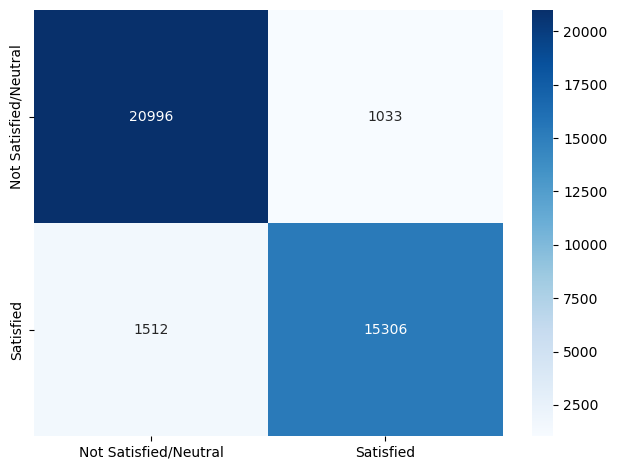

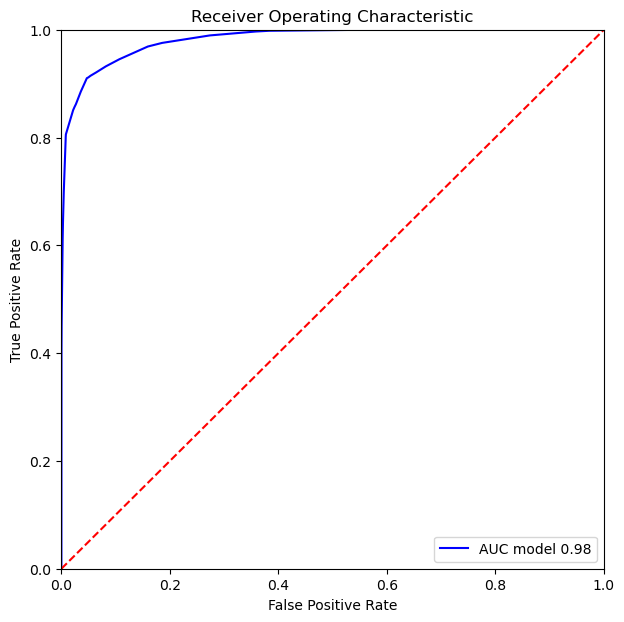

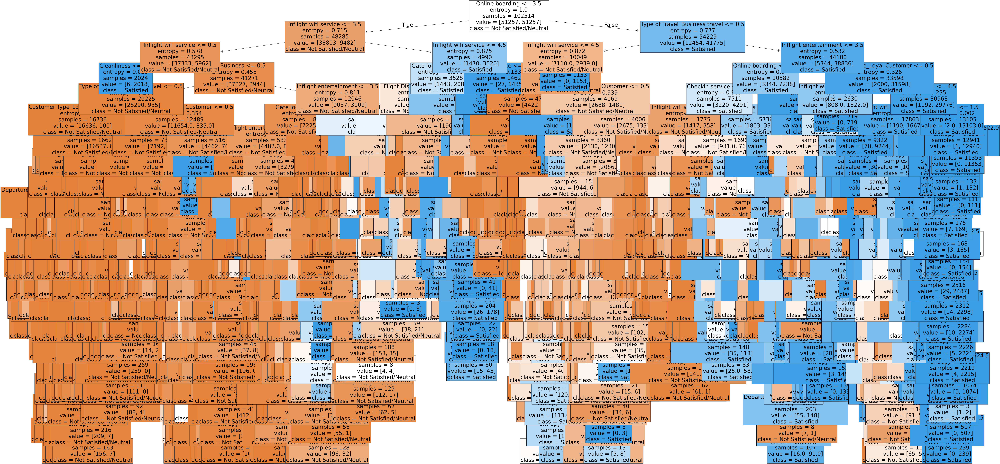

In [241]:
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state=42,ccp_alpha=0.002)
model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

from sklearn.metrics import classification_report

print("Decision Tree Model Performance:/n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Not Satisfied/Neutral', 'Satisfied']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#Plot AUC-ROC

y_proba = model.predict_proba(x_test)[:, 1]


false_positive_rate_1, true_positive_rate_1, thresholds_1 = roc_curve(y_test, y_proba)
roc_auc_1 = auc(false_positive_rate_1, true_positive_rate_1)

 
plt.figure(figsize=(7,7))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate_1, true_positive_rate_1, 'b', label = 'AUC model %0.2f'  % roc_auc_1)

plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

# Plot the decision tree
fig, ax = plt.subplots(figsize=(96, 48), dpi=100)
features = x_train.columns  # Use feature names from your dataset
classes = ['Not Satisfied/Neutral', 'Satisfied']

plot_tree(pipeline.named_steps['clf'], ax=ax, feature_names=features, class_names=classes, filled=True, fontsize=32)
plt.show()